In [1]:
%load_ext autoreload

In [2]:
%autoreload 2

In [109]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal as signal
import scipy.stats as stats
import utils
import ClinicSession as cs
import plotly.express as px
import joypy
from plotly.offline import init_notebook_mode
import json

In [4]:
init_notebook_mode(connected=True)

In [5]:
dirs = ["/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Left/Session1644435244768/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Left/Session1644436982445/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Left/Session1644437902124/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Left/Session1644438751754/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Left/Session1644439504890/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Left/Session1644440535045/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Right/Session1644435231285/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Right/Session1644436978497/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Right/Session1644437898478/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Right/Session1644438731885/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Right/Session1644439524246/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Right/Session1644440534197/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Left/Session1644445299367/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Left/Session1644445990127/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Left/Session1644446809805/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Left/Session1644447650373/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Left/Session1644448485801/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Left/Session1644449454469/DeviceNPC700398H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Right/Session1644445289099/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Right/Session1644445967527/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Right/Session1644446809128/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Right/Session1644447673534/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Right/Session1644448478426/DeviceNPC700404H",
        "/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/ON_med/Right/Session1644449434892/DeviceNPC700404H"];


In [6]:
sessions = []
lefts = np.array([1,1,1,1,1,1,0,0,0,0,0,0,1,1,1,1,1,1,0,0,0,0,0,0])
meds = np.concatenate((np.zeros(12, dtype=int), np.ones(12, dtype=int)))
UPDRSs = np.array([0,0,1,1,1,0,0,0,1,1,1,0,1,1,0,0,1,0,1,1,0,0,1,0])
level = np.array([0,2,2,0,1,1,0,2,2,0,1,1,1,2,0,1,0,2,1,2,0,1,0,2])
med = ['OFF', 'ON']
sides = ['right', 'left']
types = ['ADL', 'UPDRS']
levels = ['zero', 'low', 'high']


for i in np.arange(len(dirs)):
    sessions.append(cs.ClinicSession(dirs[i]+"/combinedDataTable.csv", dirs[i]+"/stimLog.csv", med[meds[i]], sides[lefts[i]], levels[level[i]], types[UPDRSs[i]]))

In [7]:
def create_in_visit_table(dataframe):
    dataframe['session_number'] = [str[str.find('Session'):str.find('/Device')] for str in dirs]
    dataframe['time_domain'] = [sesh.rcs_df for sesh in dataframe['sessions']]
    dataframe['stimLog'] = [sesh.stim_df for sesh in dataframe['sessions']]
    dataframe['med_state'] = [sesh.med_state for sesh in dataframe['sessions']]
    dataframe['side'] = [sesh.side for sesh in dataframe['sessions']]
    dataframe['stim_level'] = [sesh.stim_level for sesh in dataframe['sessions']]
    dataframe['assessment'] = [sesh.assessment for sesh in dataframe['sessions']]

In [8]:
clinic02_df = pd.DataFrame(sessions, columns=['sessions'])
create_in_visit_table(clinic02_df)

In [9]:
clinic02_df

,sessions,session_number,time_domain,stimLog,med_state,side,stim_level,assessment
0,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644435244768,localTime DerivedTim...,HostUnixTime active...,OFF,left,zero,ADL
1,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644436982445,localTime DerivedTim...,HostUnixTime active...,OFF,left,high,ADL
2,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644437902124,localTime DerivedTim...,HostUnixTime active...,OFF,left,high,UPDRS
3,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644438751754,localTime DerivedTim...,HostUnixTime active...,OFF,left,zero,UPDRS
4,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644439504890,localTime DerivedTim...,HostUnixTime active...,OFF,left,low,UPDRS
5,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644440535045,localTime DerivedTim...,HostUnixTime active...,OFF,left,low,ADL
6,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644435231285,localTime DerivedTim...,HostUnixTime active...,OFF,right,zero,ADL
7,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644436978497,localTime DerivedTim...,HostUnixTime active...,OFF,right,high,ADL
8,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644437898478,localTime DerivedTim...,HostUnixTime active...,OFF,right,high,UPDRS
9,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644438731885,localTime DerivedTim...,HostUnixTime active...,OFF,right,zero,UPDRS


In [10]:
def adjust_time_domain(sesh_row, stim_amp):
    """
    Returns the time block that corresponds to the stim_amp, in Unix time, for a specific session
    :param sesh_row: One row of the dataframe that contains all recording sessions
    :param stim_amp: The numerical stimulation amplitude that corresponds to either 'zero', 'low', or 'high' for that participant
    Assumes that there is only one, continuous, time segment at the desired stimulation level
    :return: time_stamp: 1x2 Array that contains Unix timestamps
    """
    time_stamp = [0, -1]
    therapy_row = 0
    for amp_setting in sesh_row['stimLog']['therapyStatusDescription']:
        if str(stim_amp)+'mA' in amp_setting:
            time_stamp[0] = sesh_row['stimLog'].index[therapy_row][0]
            if therapy_row < (len(sesh_row['stimLog']['therapyStatusDescription']) - 1):
                time_stamp[1] = sesh_row['stimLog'].index[therapy_row+1][0]
            if therapy_row == (len(sesh_row['stimLog']['therapyStatusDescription']) - 1):
                time_stamp[1] = -1
        therapy_row += 1
    return time_stamp




In [11]:
def parse_times(dataframe, level_dict, side):
    """
    Adds the time stamps to 'timestamps' column that correspond to the desired stimulation level, as determined by level_dict
    :param dataframe: pandas dataframe of recording sessions, with empty 'timestamps' column
    :param level_dict: dictionary with keys 'zero', 'low', 'high', and the corresponding stimulation levels for that participant
    :param side: hemisphere
    :return:
    """
    for key in level_dict:
        time_stamps = []
        rel_rows = dataframe.loc[dataframe['stim_level'].isin([key]) & (dataframe['side'] == side)]
        for row in np.arange(len(rel_rows)):
            current_session = rel_rows.iloc[row]
            time_stamps.append(adjust_time_domain(current_session, level_dict[key]))
        ind = 0
        for i in rel_rows.index:
            dataframe.loc[i,'timestamps'] = np.asarray(time_stamps[ind])
            ind += 1



In [12]:
def extract_stim_times(dataframe, left_level_dict, right_level_dict):
    """
    Adds timestamp columns and a 1x2 array of relevant time blocks as values. 1x2 array is timestamps for the desired stimulation level for that specific session (i.e row)
    :param dataframe: pandas dataframe of recording sessions, with empty 'timestamps' column
    :param left_level_dict: dictionary with keys 'zero', 'low', 'high', and the corresponding stimulation levels for that participant and hemisphere
    :param right_level_dict: dictionary with keys 'zero', 'low', 'high', and the corresponding stimulation levels for that participant and hemisphere
    :return:
    """
    dataframe['timestamps'] = ""
    parse_times(dataframe, left_level_dict, 'left')
    parse_times(dataframe, right_level_dict, 'right')

In [13]:
left_level_dict = {'zero': 0.0, 'low': 1.7, 'high': 2.5}
right_level_dict = {'zero': 0.0, 'low': 3.0, 'high': 3.4}

In [14]:
extract_stim_times(clinic02_df, left_level_dict, right_level_dict)

In [15]:
clinic02_df

,sessions,session_number,time_domain,stimLog,med_state,side,stim_level,assessment,timestamps
0,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644435244768,localTime DerivedTim...,HostUnixTime active...,OFF,left,zero,ADL,"[1644435354234, -1]"
1,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644436982445,localTime DerivedTim...,HostUnixTime active...,OFF,left,high,ADL,"[1644437187856, -1]"
2,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644437902124,localTime DerivedTim...,HostUnixTime active...,OFF,left,high,UPDRS,"[1644437903475, -1]"
3,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644438751754,localTime DerivedTim...,HostUnixTime active...,OFF,left,zero,UPDRS,"[1644438850556, -1]"
4,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644439504890,localTime DerivedTim...,HostUnixTime active...,OFF,left,low,UPDRS,"[1644439754524, -1]"
5,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644440535045,localTime DerivedTim...,HostUnixTime active...,OFF,left,low,ADL,"[1644440536426, -1]"
6,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644435231285,localTime DerivedTim...,HostUnixTime active...,OFF,right,zero,ADL,"[1644435357391, -1]"
7,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644436978497,localTime DerivedTim...,HostUnixTime active...,OFF,right,high,ADL,"[1644437176246, -1]"
8,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644437898478,localTime DerivedTim...,HostUnixTime active...,OFF,right,high,UPDRS,"[1644437900277, -1]"
9,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644438731885,localTime DerivedTim...,HostUnixTime active...,OFF,right,zero,UPDRS,"[1644438850711, -1]"


In [16]:
def get_ind_from_timestamp(td_df, timestamp):
    """
    Returns the index of the time_domain dataframe that is closest to to the timestamp, as measured in DerivedTime column
    :param td_df: raw time_domain data
    :param timestamp: Unix timestamp
    :return: index of raw time_domain that is closest to Unix timestamp
    """
    if timestamp == -1:
        return None
    else: return np.argmin(np.abs(td_df['DerivedTime'] - timestamp))

In [17]:
def add_stim_time_indices(dataframe):
    """
    Adds the corresponding index from the timeDomain dataframe to each timestamp in 'timestamps' column
    :param dataframe: pandas dataframe. Must have 'timestamps' and 'time_domain' columns
    :return: None. Edits in place.
    """
    dataframe['time_indices'] = ""
    for i in dataframe.index:
        dataframe.at[i, 'time_indices'] = np.array([
            get_ind_from_timestamp(dataframe.loc[i,'time_domain'], dataframe.loc[i, 'timestamps'][0]),
            get_ind_from_timestamp(dataframe.loc[i,'time_domain'], dataframe.loc[i, 'timestamps'][1])
        ])

In [18]:
add_stim_time_indices(clinic02_df)

In [19]:
clinic02_df

,sessions,session_number,time_domain,stimLog,med_state,side,stim_level,assessment,timestamps,time_indices
0,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644435244768,localTime DerivedTim...,HostUnixTime active...,OFF,left,zero,ADL,"[1644435354234, -1]","[50984, None]"
1,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644436982445,localTime DerivedTim...,HostUnixTime active...,OFF,left,high,ADL,"[1644437187856, -1]","[99335, None]"
2,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644437902124,localTime DerivedTim...,HostUnixTime active...,OFF,left,high,UPDRS,"[1644437903475, -1]","[0, None]"
3,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644438751754,localTime DerivedTim...,HostUnixTime active...,OFF,left,zero,UPDRS,"[1644438850556, -1]","[45738, None]"
4,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644439504890,localTime DerivedTim...,HostUnixTime active...,OFF,left,low,UPDRS,"[1644439754524, -1]","[111232, None]"
5,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644440535045,localTime DerivedTim...,HostUnixTime active...,OFF,left,low,ADL,"[1644440536426, -1]","[0, None]"
6,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644435231285,localTime DerivedTim...,HostUnixTime active...,OFF,right,zero,ADL,"[1644435357391, -1]","[52151, None]"
7,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644436978497,localTime DerivedTim...,HostUnixTime active...,OFF,right,high,ADL,"[1644437176246, -1]","[93078, None]"
8,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644437898478,localTime DerivedTim...,HostUnixTime active...,OFF,right,high,UPDRS,"[1644437900277, -1]","[0, None]"
9,<ClinicSession.ClinicSession object at 0x7fb03...,Session1644438731885,localTime DerivedTim...,HostUnixTime active...,OFF,right,zero,UPDRS,"[1644438850711, -1]","[44903, None]"


In [20]:
def get_TD_data(sessions, channel, zero_pad=False, zero_pad_length=500):
    """
    Returns the time domain data within time_ind of each session, concatenated together
    :param sessions: pandas dataframe
    :param channel: Which time domain channel. TD_key0, TD_key1, TD_key2, TD_key3
    :return: 1D Numpy Array of time domain data
    """
    td_data = []

    if isinstance(sessions, pd.DataFrame):
        for i in sessions.index:
            start = sessions.loc[i,'time_indices'][0]
            end = sessions.loc[i,'time_indices'][1]
            if zero_pad:
                # Need to remove nan_to_num..
                td_data.append(np.zeros(zero_pad_length))
                td_data.append(sessions.loc[i,'time_domain'][channel][start:end])
            else:
                td_data.append(sessions.loc[i,'time_domain'][channel][start:end])
    else:
        start = sessions['time_indices'][0]
        end = sessions['time_indices'][1]
        td_data.append(sessions['time_domain'][channel][start:end])


    return td_data

In [21]:
def compute_PSD(sessions, sample_rate, num_per_seg, nfft, zero_pad, zero_pad_length, td_channel='TD_key3', overlap=0, use_scipy=False):
    """

    :param sessions:
    :param sample_rate:
    :param num_per_seg:
    :param nfft:
    :param zero_pad:
    :param zero_pad_length:
    :param td_channel:
    :param overlap:
    :return:
    """
    td_parsed = get_TD_data(sessions, td_channel, zero_pad, zero_pad_length)
    f = [0]
    if use_scipy:
        f, Pxx_den = signal.welch(td_parsed, fs=sample_rate, nperseg=num_per_seg, noverlap=overlap, nfft=nfft, detrend=False)
        return f, Pxx_den
    else:
        PSDs = []
        for arr in td_parsed:
            curr_idx = 0
            num_windows = (np.size(arr) - num_per_seg) // (num_per_seg - overlap)
            if num_windows > 0:
                for i in range(num_windows):
                    curr_window = arr[curr_idx:curr_idx+num_per_seg]
                    f, psd_tmp = signal.welch(curr_window, fs=sample_rate, nperseg=num_per_seg, noverlap=None)
                    if not np.isnan(psd_tmp).any():
                        PSDs.append(psd_tmp)
                    curr_idx += overlap
    if f.any():
        return f, PSDs
    else:
        return None, None


In [22]:
def plot_specified_PSDs(psds, labels, ax, title, freq_range=[1,100]):
    """

    :param psds:
    :param labels:
    :param ax:
    :param freq_range:
    :return:
    """
    ax.set_ylabel('PSD [mV**2/Hz]', size=15)
    for i in range(len(psds)):
        ax.semilogy(f[freq_range[0]:freq_range[1]], psds[i][freq_range[0]:freq_range[1]], label=labels[i])

    ax.legend(prop={'size': 10})
    ax.set_title(title, size=20)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_ylim(10 ** -8, 1.3 * 10 ** -4)
    #ax.yaxis.set_ticks([10 ** -7, 10 ** -6, 10 ** -5, 10 ** -4], ['1e-7', '1e-6', '1e-5', '1e-4'])
    ax.set_yticks([10 ** -7, 10 ** -6, 10 ** -5, 10 ** -4])
    ax.set_yticklabels(['1e-7', '1e-6', '1e-5', '1e-4'])
    ax.set_xticks([0, 20, 40, 60, 80, 100])
    ax.set_xticklabels([0, 20, 40, 60, 80, 100])
    ax.tick_params(axis='both', which='major', labelsize=15)

In [23]:
def plot_PSD_across_med_stim_states(dataframe, hemisphere, sample_rate, num_per_seg, nfft, zero_pad, zero_pad_length, title, td_channel='TD_key3', freq_range=[1, 100], overlap=None, ax=None):
    """
    Plots the PSD time domain 'td_channel' of across sessions with same hemisphere, med state, and stim state.
    :param sessions: List of recording sessions objects
    :param sample_rate: Time Domain sample rate (int)
    :param window_length: number of data points for each FFT window (int)
    :param title: Figure Title (str)
    :param td_channel: td_channel name for pandas column which is to be analyzed (Usually TD_key[0-3])
    :param freq_range: Range of frequencies to plot on x-axis. 1x2 int array
    :return:
    """

    periodograms = []
    STIM_LIST = ['low', 'high']
    MED_STATES = ['ON', 'OFF']
    LABELS = ['ON med, Low stim', 'ON med, High stim', 'OFF med, Low stim', 'OFF med, High stim']

    for state in MED_STATES:
        for level in STIM_LIST:
            rel_rows = dataframe.loc[(dataframe['stim_level'] == level) & (dataframe['side'] == hemisphere) & (dataframe['med_state'] == state)]
            # td_parsed = get_TD_data(rel_rows, td_channel, zero_pad, zero_pad_length)
            # f, Pxx_den = signal.welch(td_parsed, fs=sample_rate, nperseg=num_per_seg, noverlap=overlap, nfft=nfft)
            f, Pxx_den = compute_PSD(rel_rows, sample_rate, num_per_seg, nfft, False, 0, td_channel, overlap=overlap)
            periodograms.append(np.mean(Pxx_den,axis=0))


    if ax is None:
        plt.figure(figsize=(10, 8))
        plt.xlabel('Frequency [Hz]', size=15)
        plt.ylabel('PSD [mV**2/Hz]', size=15)
        for i in range(len(LABELS)):
            plt.semilogy(f[freq_range[0]:freq_range[1]], periodograms[i][freq_range[0]:freq_range[1]], label=LABELS[i])

        plt.legend(prop={'size': 20})
        plt.title(title, size=20)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['top'].set_visible(False)
        plt.ylim(10 ** -8, 1.3 * 10 ** -4)
        plt.yticks([10 ** -7, 10 ** -6, 10 ** -5, 10 ** -4], labels=['1e-7', '1e-6', '1e-5', '1e-4'], size=15)
        plt.xticks(size=15)
        plt.show()
    else:
        #ax.set_xlabel('Frequency [Hz]', size=15)
        ax.set_ylabel('PSD [mV**2/Hz]', size=15)
        for i in range(len(LABELS)):
            ax.semilogy(f[freq_range[0]:freq_range[1]], periodograms[i][freq_range[0]:freq_range[1]], label=LABELS[i])

        ax.legend(prop={'size': 10})
        ax.set_title(title, size=20)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.set_ylim(10 ** -8, 1.3 * 10 ** -4)
        #ax.yaxis.set_ticks([10 ** -7, 10 ** -6, 10 ** -5, 10 ** -4], ['1e-7', '1e-6', '1e-5', '1e-4'])
        ax.set_yticks([10 ** -7, 10 ** -6, 10 ** -5, 10 ** -4])
        ax.set_yticklabels(['1e-7', '1e-6', '1e-5', '1e-4'])
        ax.set_xticks([0, 20, 40, 60, 80, 100])
        ax.set_xticklabels([0, 20, 40, 60, 80, 100])
        ax.tick_params(axis='both', which='major', labelsize=15)


In [25]:
def plot_ridge(sessions, nperseg, overlap, channel, slice, x_range, colormap=plt.cm.Purples_r):
    f, psds_tmp = compute_PSD(sessions, 500, nperseg, 512, False, 0, channel, overlap=overlap)
    fig, ax = joypy.joyplot(list(np.log10(np.array(psds_tmp).T[slice])), labels=[str(x)[:-2] for x in f[slice]], x_range=x_range,
                        fade=False, alpha=0.2, background='k', linecolor="w", colormap=colormap, figsize=(8,10))
    plt.show()

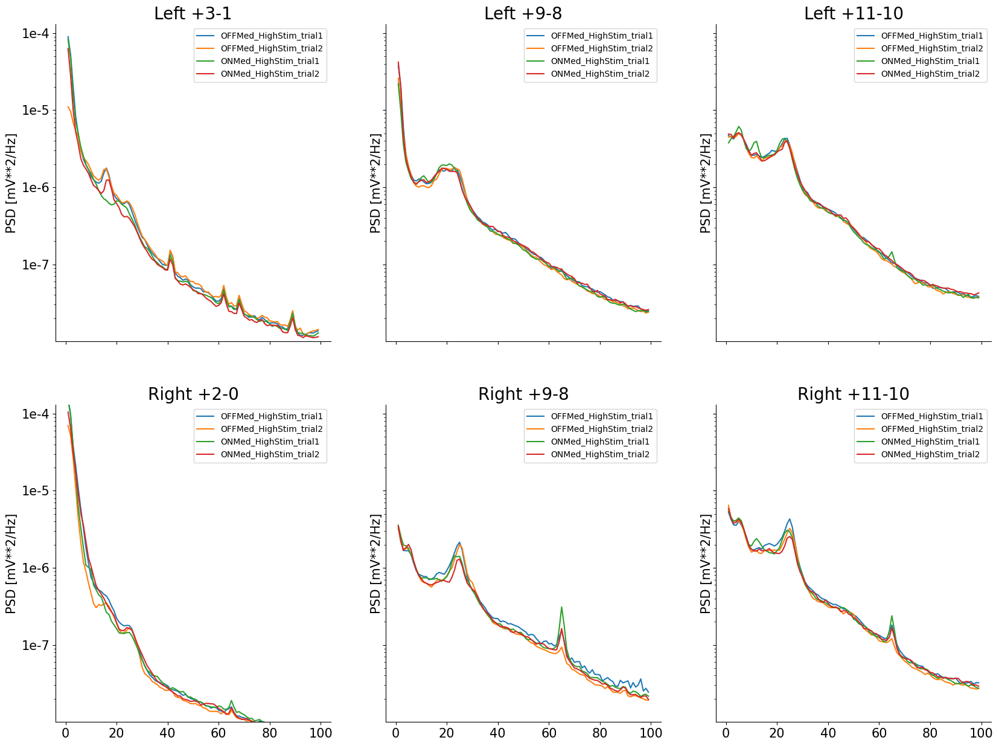

In [24]:
fig, axs = plt.subplots(2, 3, figsize=(20,15), sharex='all', sharey='all')
axs = axs.ravel()
slice = clinic02_df.loc[clinic02_df["stim_level"] == 'high']
sides = ['left', 'right']
med_state = ['OFF', 'ON']
channels = ['TD_key0', 'TD_key2', 'TD_key3']
titles = ['Left +3-1', 'Left +9-8', 'Left +11-10', 'Right +2-0', 'Right +9-8', 'Right +11-10']
ind = 0
for i in sides:
    for j in channels:
        for k in med_state:
            pxx = []
            sessions = slice.loc[(slice['side'] == i) & (slice['med_state'] == k)]
            for l in sessions.index:
                f, pxx_den = compute_PSD(sessions.loc[l], 500, 500, 512, False, 0, j, overlap=250)
                pxx.append(np.mean(pxx_den, axis=0))
            labels = [k+'Med_HighStim_trial1', k+'Med_HighStim_trial2']
            plot_specified_PSDs(pxx, labels, axs[ind], titles[ind])
        ind += 1
plt.show()


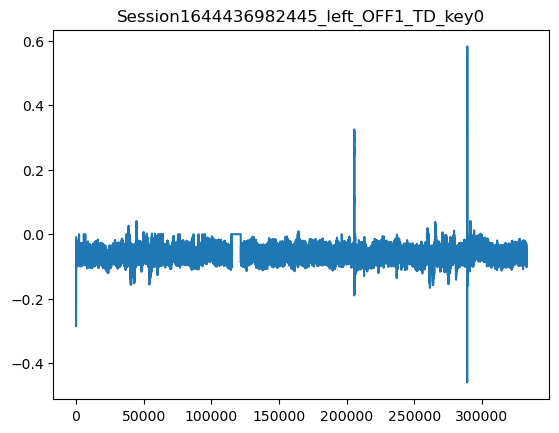

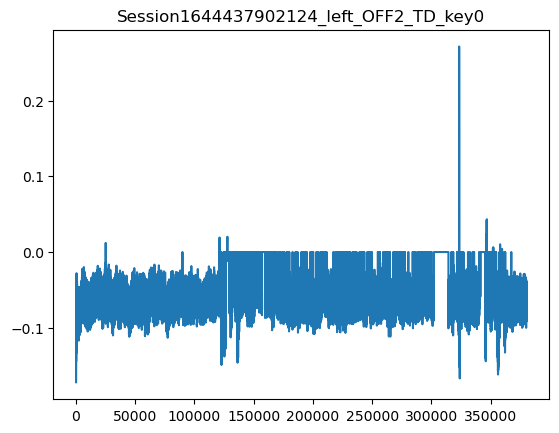

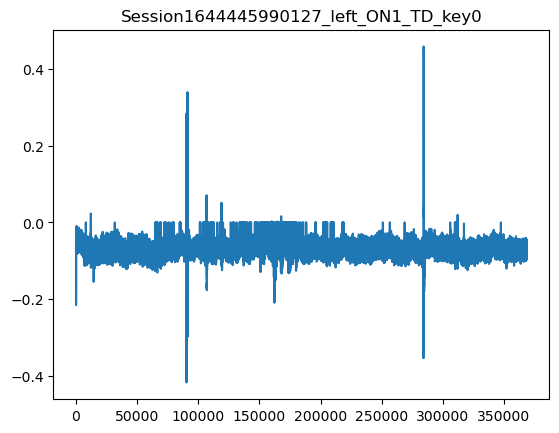

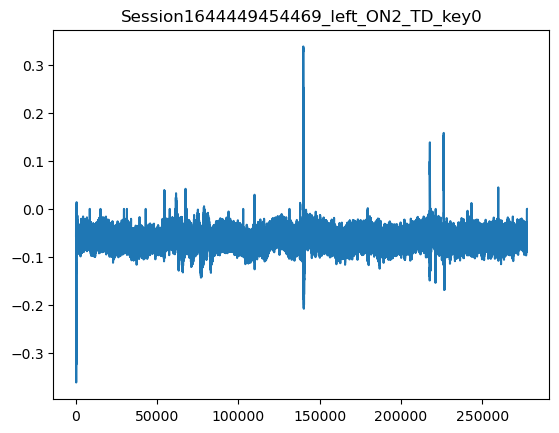

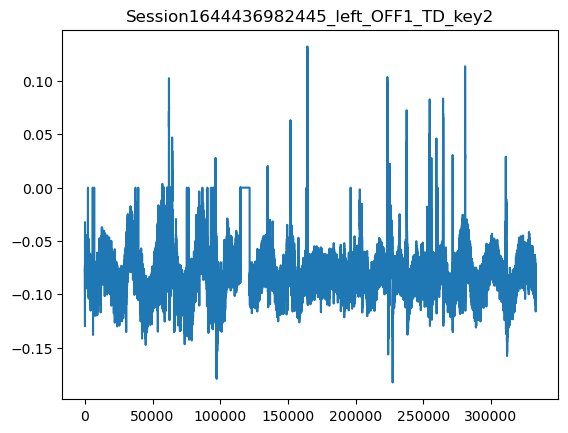

...

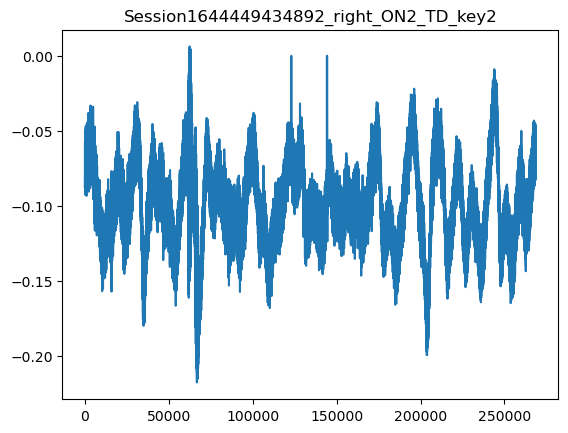

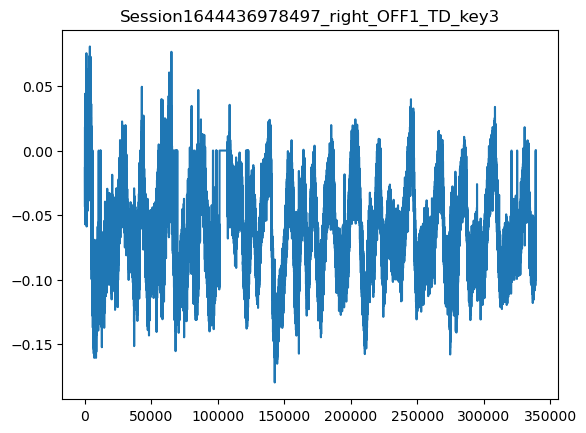

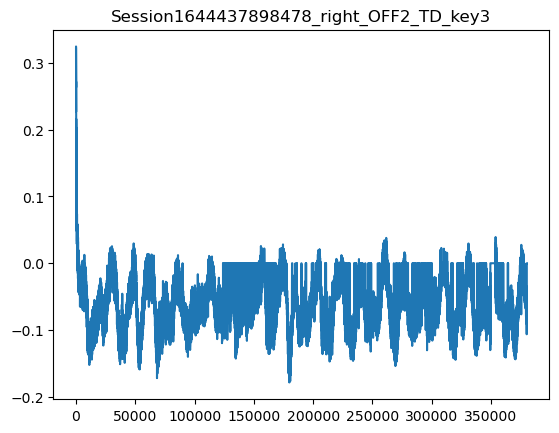

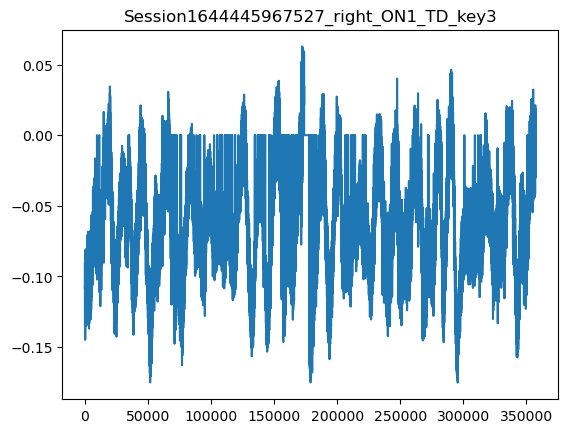

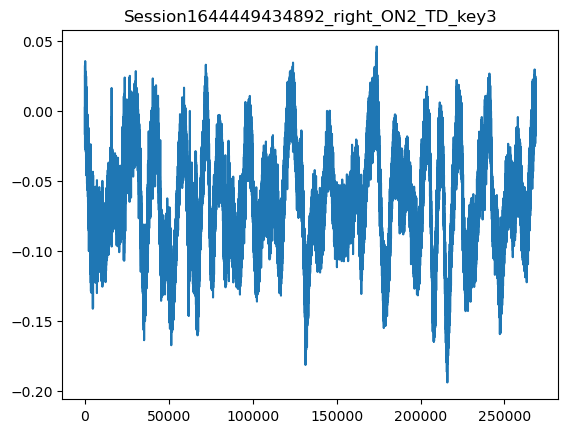

In [40]:
#fig, axs = plt.subplots(2, 3, figsize=(20,15), sharex='all', sharey='all')
#axs = axs.ravel()
slice = clinic02_df.loc[clinic02_df["stim_level"] == 'high']
sides = ['left', 'right']
med_state = ['OFF', 'ON']
channels = ['TD_key0', 'TD_key2', 'TD_key3']
titles = ['Left +3-1', 'Left +9-8', 'Left +11-10', 'Right +2-0', 'Right +9-8', 'Right +11-10']
ind = 0
for i in sides:
    for j in channels:
        for k in med_state:
            time_domain = []
            sessions = slice.loc[(slice['side'] == i) & (slice['med_state'] == k)]
            ind = 1
            for l in sessions.index:
                plt.plot(get_TD_data(sessions.loc[l], j))
                plt.title(f"{sessions.loc[l,'session_number']}_{i}_{k}{ind}_{j}")
                ind+=1
                plt.show()

In [88]:
data = get_TD_data(clinic02_df.loc[2], channel='TD_key0')

In [91]:
np.shape(data)

(1, 380573)

In [92]:
fig = px.line(x=np.arange(len(data[0])), y=data)
fig.show()

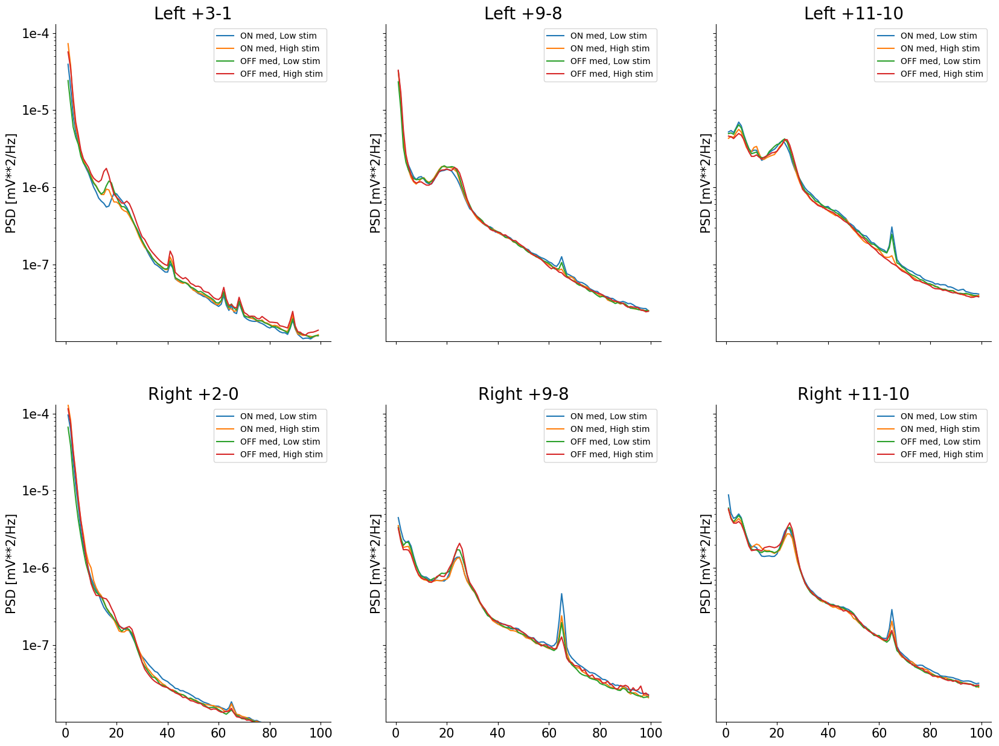

In [73]:
fig, axs = plt.subplots(2, 3, figsize=(20,15), sharex='all', sharey='all')
axs = axs.ravel()
sides = ['left', 'right']
channels = ['TD_key0', 'TD_key2', 'TD_key3']
titles = ['Left +3-1', 'Left +9-8', 'Left +11-10', 'Right +2-0', 'Right +9-8', 'Right +11-10']
ind = 0
for i in sides:
    for j in channels:
        plot_PSD_across_med_stim_states(clinic02_df, i, 500, 500, 512, False, 0, titles[ind], td_channel=j, freq_range=[1, 100], overlap=None, ax=axs[ind])
        ind += 1
plt.show()

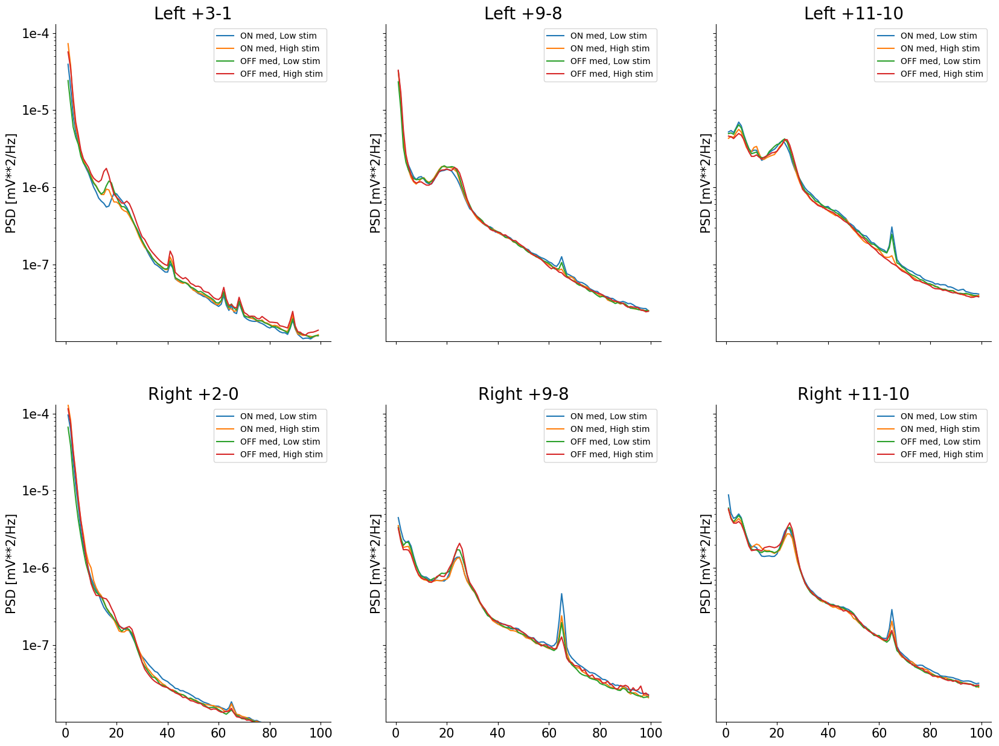

In [74]:
fig, axs = plt.subplots(2, 3, figsize=(20,15), sharex='all', sharey='all')
axs = axs.ravel()
sides = ['left', 'right']
channels = ['TD_key0', 'TD_key2', 'TD_key3']
titles = ['Left +3-1', 'Left +9-8', 'Left +11-10', 'Right +2-0', 'Right +9-8', 'Right +11-10']
ind = 0
for i in sides:
    for j in channels:
        plot_PSD_across_med_stim_states(clinic02_df, i, 500, 500, 512, False, 0, titles[ind], td_channel=j, freq_range=[1, 100], overlap=250, ax=axs[ind])
        ind += 1
plt.show()

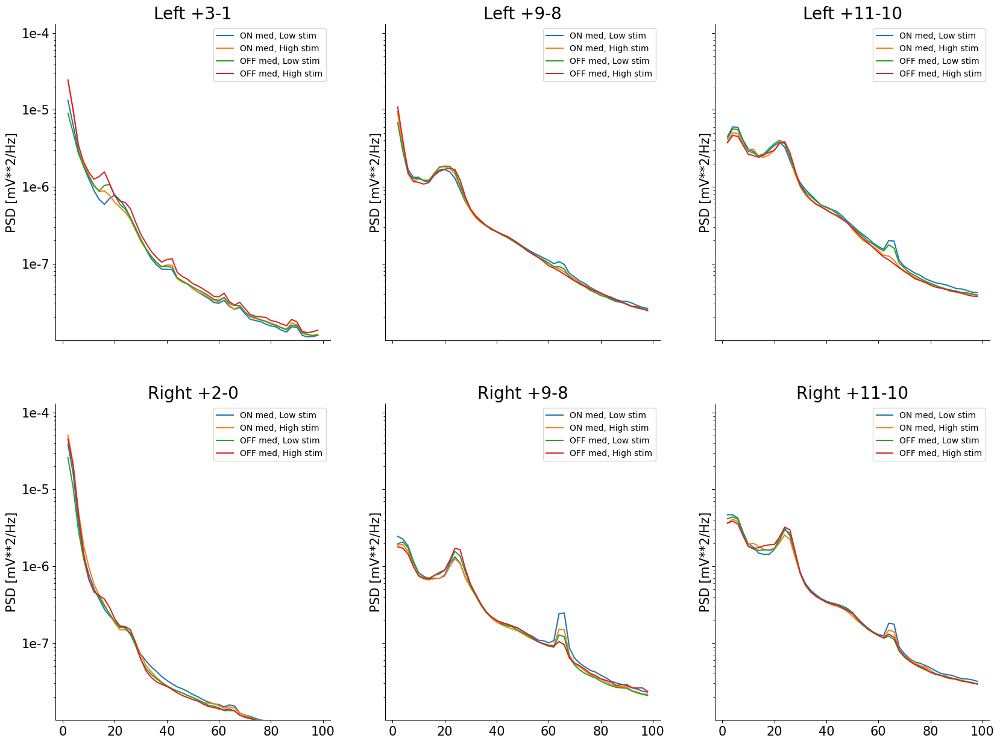

In [307]:
fig, axs = plt.subplots(2, 3, figsize=(20,15), sharex='all', sharey='all')
axs = axs.ravel()
sides = ['left', 'right']
channels = ['TD_key0', 'TD_key2', 'TD_key3']
titles = ['Left +3-1', 'Left +9-8', 'Left +11-10', 'Right +2-0', 'Right +9-8', 'Right +11-10']
ind = 0
for i in sides:
    for j in channels:
        plot_PSD_across_med_stim_states(clinic02_df, i, 500, 250, None, False, 0, titles[ind], td_channel=j, freq_range=[1, 50], overlap=125, ax=axs[ind])
        ind += 1
plt.show()

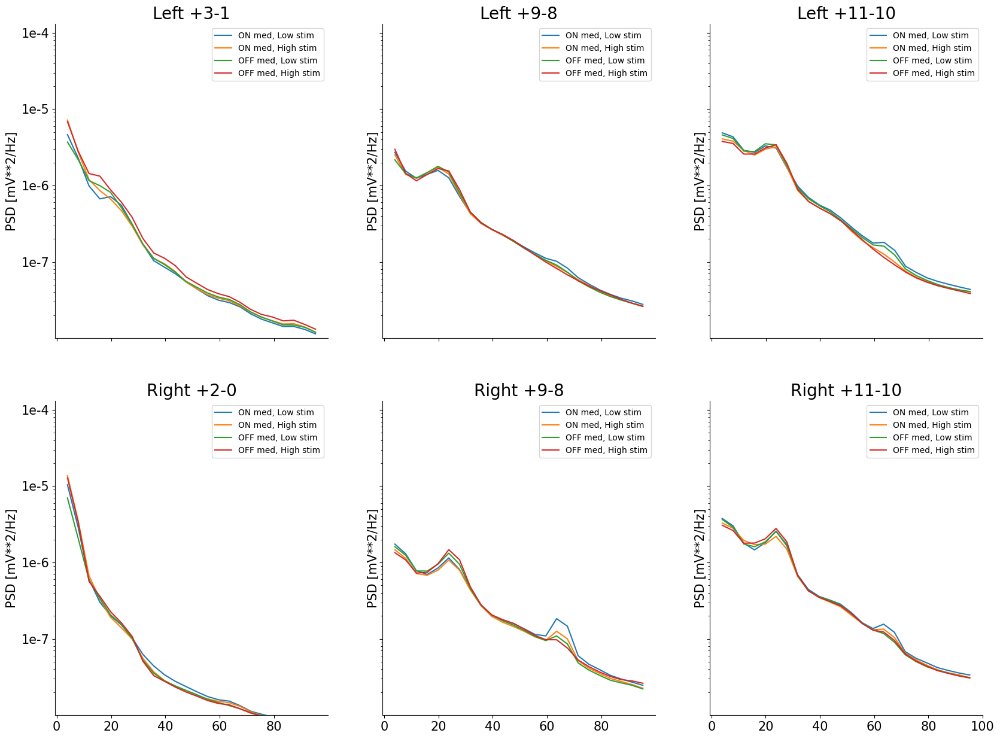

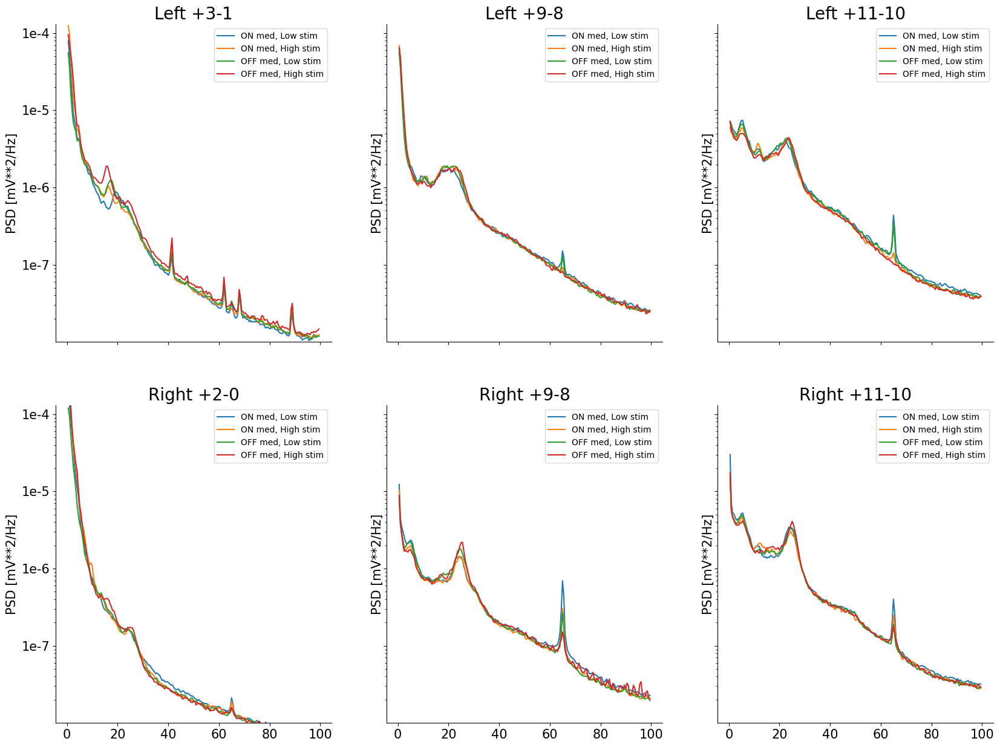

In [311]:
fig, axs = plt.subplots(2, 3, figsize=(20,15), sharex='all', sharey='all')
axs = axs.ravel()
sides = ['left', 'right']
channels = ['TD_key0', 'TD_key2', 'TD_key3']
titles = ['Left +3-1', 'Left +9-8', 'Left +11-10', 'Right +2-0', 'Right +9-8', 'Right +11-10']
ind = 0
for i in sides:
    for j in channels:
        plot_PSD_across_med_stim_states(clinic02_df, i, 500, 1000, None, False, 0, titles[ind], td_channel=j, freq_range=[1, 200], overlap=500, ax=axs[ind])
        ind += 1
plt.show()

In [259]:
sessions_for_joy = clinic02_df.loc[(clinic02_df['side'] == 'right') & (clinic02_df['med_state'] == 'ON') & (clinic02_df["stim_level"] == 'high')]

In [275]:
f, psds = compute_PSD(sessions_for_joy, 500, 1000, 512, False, 0, 'TD_key3', overlap=500)

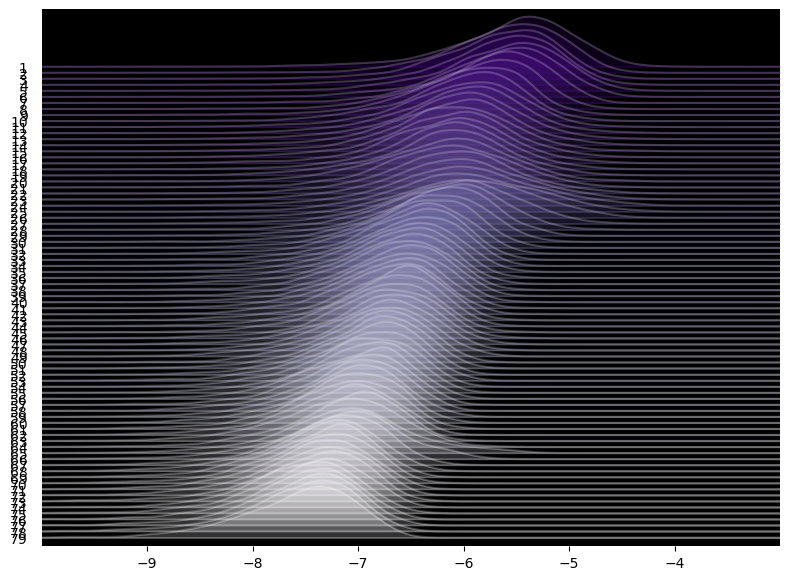

In [261]:
s = np.s_[1:80]
xr = [-10,-3]

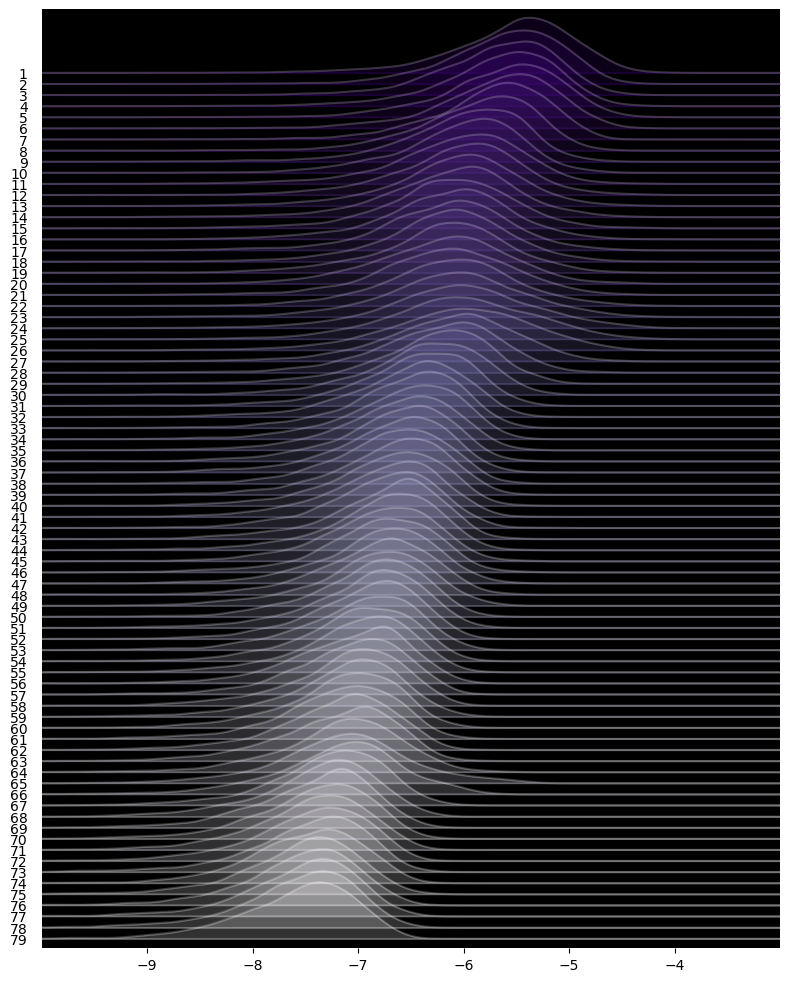

In [270]:
s = np.s_[1:80]
f, psds = compute_PSD(sessions_for_joy, 500, 500, 512, False, 0, 'TD_key3', overlap=250)
fig, ax = joypy.joyplot(list(np.log10(np.array(psds).T[s])), labels=[str(x)[:-2] for x in f[s]], x_range=xr,
                        fade=False, alpha=0.2, background='k', linecolor="w", colormap=plt.cm.Purples_r, figsize=(8,10))
#colormap=plt.cm.autumn_r
plt.show()

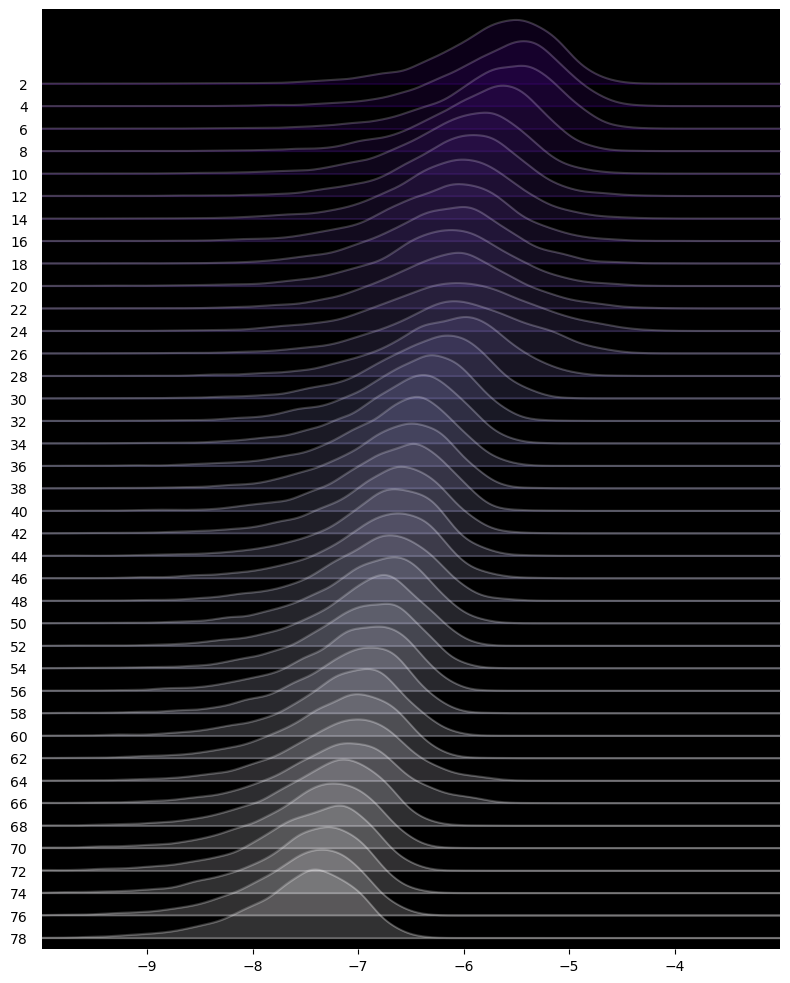

In [279]:
s = np.s_[1:40]
f, psds = compute_PSD(sessions_for_joy, 500, 250, 512, False, 0, 'TD_key3', overlap=125)
fig, ax = joypy.joyplot(list(np.log10(np.array(psds).T[s])), labels=[str(x)[:-2] for x in f[s]], x_range=xr,
                        fade=False, alpha=0.2, background='k', linecolor="w", colormap=plt.cm.Purples_r, figsize=(8,10))
#colormap=plt.cm.autumn_r
plt.show()

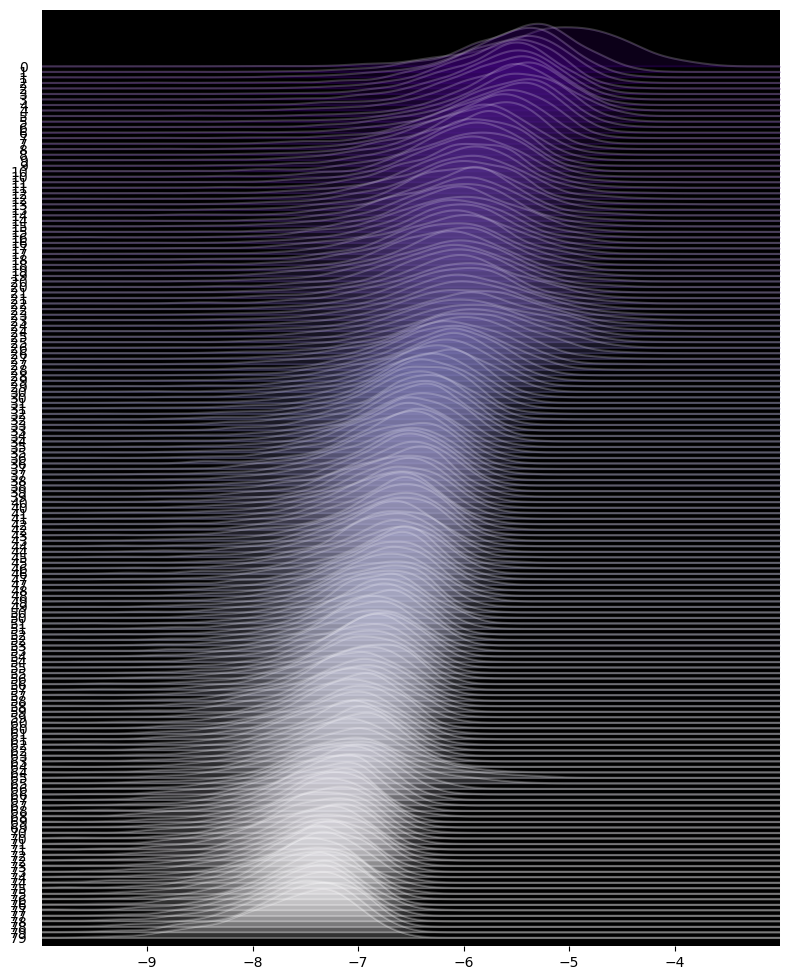

In [278]:
s = np.s_[1:160]
f, psds = compute_PSD(sessions_for_joy, 500, 1000, 512, False, 0, 'TD_key3', overlap=500)
fig, ax = joypy.joyplot(list(np.log10(np.array(psds).T[s])), labels=[str(x)[:-2] for x in f[s]], x_range=xr,
                        fade=False, alpha=0.2, background='k', linecolor="w", colormap=plt.cm.Purples_r, figsize=(8,10))
#colormap=plt.cm.autumn_r
plt.show()

In [27]:
sessions_for_joy_zero = clinic02_df.loc[(clinic02_df['side'] == 'right') & (clinic02_df['med_state'] == 'ON') & (clinic02_df["stim_level"] == 'zero')]

In [28]:
f, psds_2 = compute_PSD(sessions_for_joy_zero, 500, 500, 512, False, 0, 'TD_key0', overlap=250)

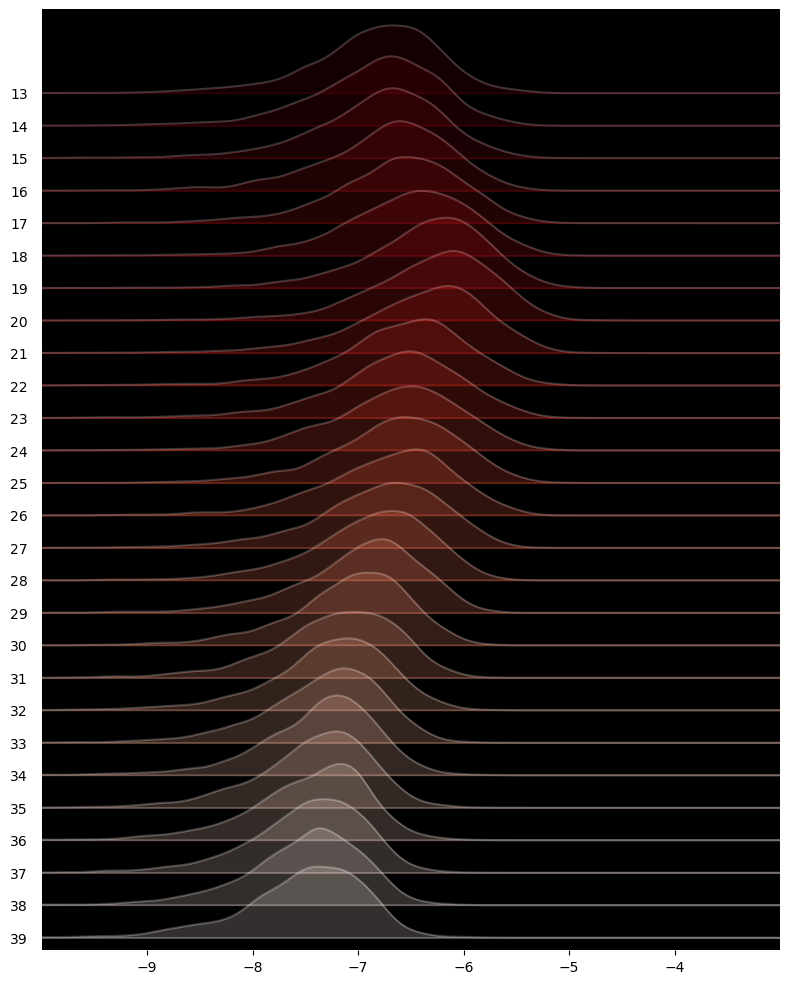

In [295]:
s = np.s_[13:40]
psd_2[]
fig, ax2 = joypy.joyplot(list(np.log10(np.array(psds_2).T[s])), labels=[str(x)[:-2] for x in f[s]], x_range=xr,
                        fade=False, alpha=0.2, background='k', linecolor="w", colormap=plt.cm.Reds_r, figsize=(8,10))
plt.show()

In [280]:
sessions_for_joy_zero_OFF = clinic02_df.loc[(clinic02_df['side'] == 'right') & (clinic02_df['med_state'] == 'OFF') & (clinic02_df["stim_level"] == 'zero')]

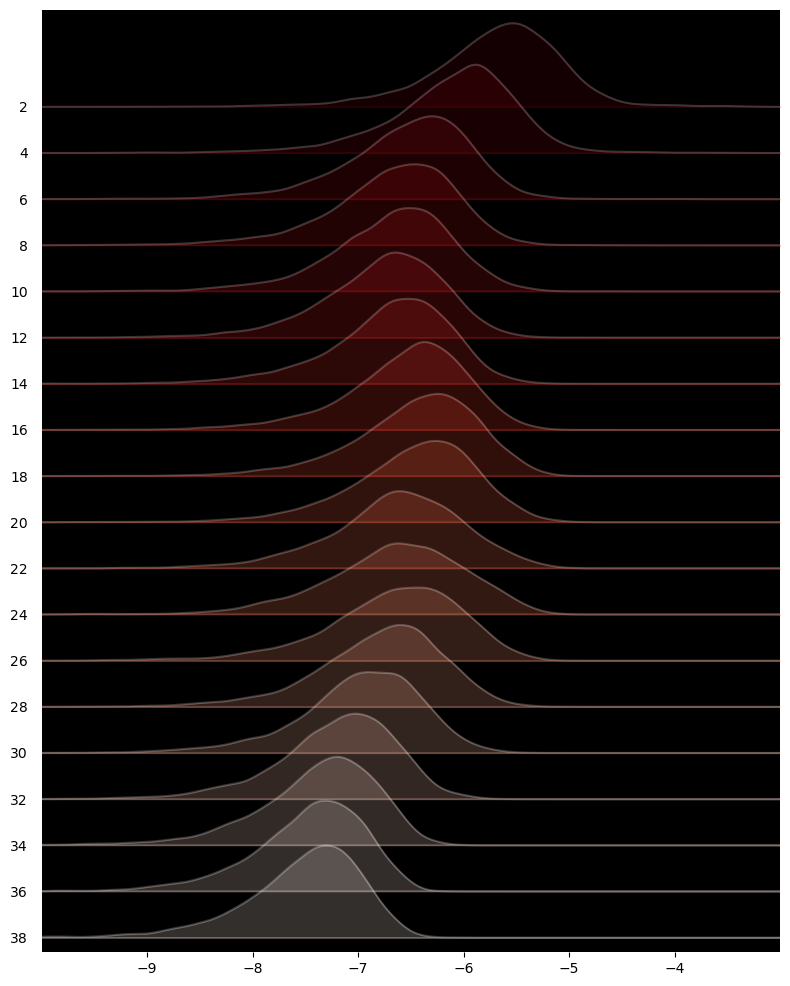

In [291]:
s = np.s_[1:20]
f, psds_3 = compute_PSD(sessions_for_joy_zero_OFF, 500, 250, 512, False, 0, 'TD_key0', overlap=125)
fig, ax2 = joypy.joyplot(list(np.log10(np.array(psds_3).T[s])), labels=[str(x)[:-2] for x in f[s]], x_range=xr,
                         fade=False, alpha=0.2, background='k', linecolor="w", colormap=plt.cm.Reds_r, figsize=(8,10))
plt.show()

In [26]:
sessions_for_joy_zero_OFF = clinic02_df.loc[(clinic02_df['side'] == 'left') & (clinic02_df['med_state'] == 'OFF') & (clinic02_df["stim_level"] == 'zero')]
sessions_for_joy_zero_ON = clinic02_df.loc[(clinic02_df['side'] == 'left') & (clinic02_df['med_state'] == 'ON') & (clinic02_df["stim_level"] == 'zero')]
plot_ridge(sessions_for_joy_zero_ON, 500, 250, 'TD_key0', np.s_[13:40], xr)
plot_ridge(sessions_for_joy_zero_OFF, 500, 250, 'TD_key0', np.s_[13:40], xr, colormap=plt.cm.Reds_r)

NameError: name 'xr' is not defined

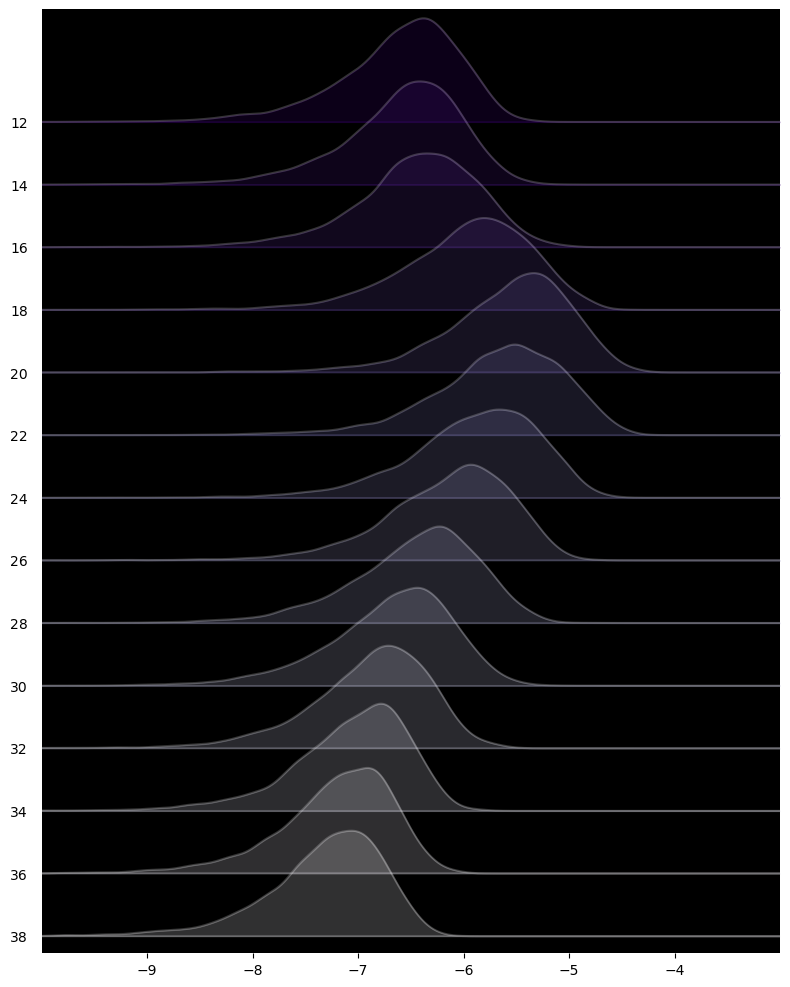

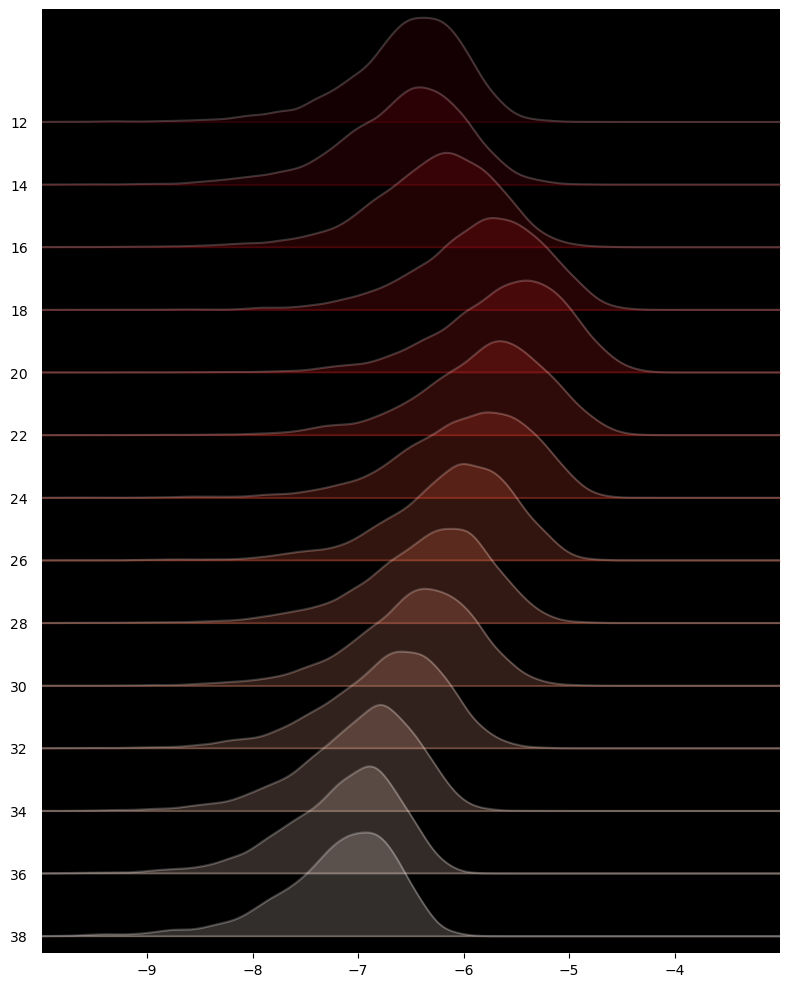

In [325]:
plot_ridge(sessions_for_joy_zero_ON, 250, 125, 'TD_key0', np.s_[6:20], xr)
plot_ridge(sessions_for_joy_zero_OFF, 250, 125, 'TD_key0', np.s_[6:20], xr, colormap=plt.cm.Reds_r)

In [30]:
sessions_for_joy_zero_OFF = clinic02_df.loc[(clinic02_df['side'] == 'left') & (clinic02_df['med_state'] == 'OFF') & (clinic02_df["stim_level"] == 'zero')]
sessions_for_joy_zero_ON = clinic02_df.loc[(clinic02_df['side'] == 'left') & (clinic02_df['med_state'] == 'ON') & (clinic02_df["stim_level"] == 'zero')]
f, psds_OFF = compute_PSD(sessions_for_joy_zero_OFF, 500, 500, 512, False, 0, 'TD_key0', overlap=250)
f, psds_ON = compute_PSD(sessions_for_joy_zero_ON, 500, 500, 512, False, 0, 'TD_key0', overlap=250)

In [31]:
psds_OFF_flat = np.array(psds_OFF)[:,:101].flatten('F')
#psds_OFF_flat_labelled = np.concatenate((psds_OFF_flat[np.newaxis].T, np.repeat(np.arange(101), np.shape(psds_OFF)[0])[np.newaxis].T), axis=1)
psds_ON_flat = np.array(psds_ON)[:,:101].flatten('F')
#psds_ON_flat_labelled = np.concatenate((psds_ON_flat[np.newaxis].T, np.repeat(np.arange(101), np.shape(psds_ON)[0])[np.newaxis].T), axis=1)

In [35]:
psds_ON_OFF_flat_labelled = np.concatenate((psds_ON_flat[np.newaxis].T, psds_OFF_flat[:np.size(psds_ON_flat)][np.newaxis].T, np.repeat(np.arange(101), np.shape(psds_ON)[0])[np.newaxis].T), axis=1)

In [37]:
df_total = pd.DataFrame(psds_ON_OFF_flat_labelled, columns=['ON_MED', 'OFF_MED', 'freq'])

In [43]:
df_total.head()

,ON_MED,OFF_MED,freq
0,0.000408,4.095099e-06,0.0
1,0.000009,1.688423e-06,0.0
2,0.000007,6.472384e-07,0.0
3,0.000003,2.428406e-08,0.0
4,0.000002,2.623182e-08,0.0


In [45]:
df_total[['ON_MED', 'OFF_MED']] = df_total[['ON_MED', 'OFF_MED']].apply(np.log10)

In [46]:
df_total

,ON_MED,OFF_MED,freq
0,-3.389549,-5.387736,0.0
1,-5.044658,-5.772519,0.0
2,-5.126159,-6.188936,0.0
3,-5.460287,-7.614679,0.0
4,-5.691124,-7.581172,0.0
...,...,...,...
248657,-7.730559,-7.590516,100.0
248658,-7.497439,-7.449291,100.0
248659,-8.002287,-8.827699,100.0
248660,-7.954020,-8.676790,100.0


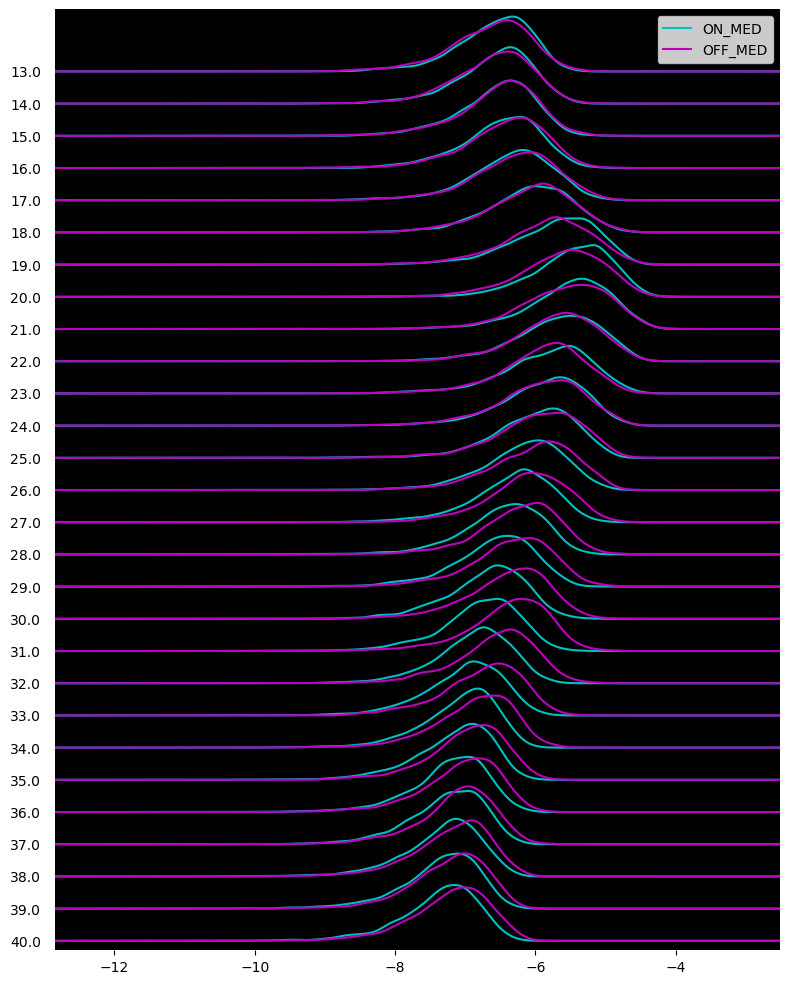

In [71]:
fig, axes = joypy.joyplot(df_total[df_total['freq'].between(13,40)], by="freq", figsize=(8,10), fill=False, legend=True, background='k', color=["c","m"])
plt.show()

In [ ]:
df_OFF = pd.DataFrame(np.array(psds_2)[:,1:101], columns=[str(x) for x in range(1,101)])

In [193]:
df_2["SessionType"] = "right_ON_zero"

In [200]:
df_2.head()

,1,2,3,4,5,6,7,8,9,10,...,91,92,93,94,95,96,97,98,99,100
0,1.781049e-05,1.520647e-05,0.000002,0.000005,0.000003,5.584495e-07,1.063348e-07,3.392407e-07,0.000001,2.641353e-06,...,5.496714e-08,5.190338e-08,6.283816e-08,8.722767e-08,5.766345e-08,8.888453e-08,2.807899e-09,3.211035e-08,6.202271e-08,2.651842e-08
1,4.837594e-08,2.476735e-07,0.000005,0.000013,0.000017,8.197998e-06,8.072651e-07,9.011874e-07,0.000003,3.959147e-07,...,5.444621e-08,6.869414e-08,1.757059e-08,1.211548e-08,2.564899e-08,1.120267e-07,6.913696e-08,3.240083e-08,9.719155e-09,3.044134e-08
2,5.173153e-07,2.301487e-07,0.000002,0.000003,0.000005,2.796919e-06,2.856880e-06,2.545177e-06,0.000006,1.208548e-05,...,1.940187e-07,8.795725e-08,1.022608e-07,8.817276e-08,2.647216e-08,8.269649e-10,8.270883e-10,1.044004e-09,3.089928e-08,3.711185e-08
3,3.941300e-06,5.587941e-06,0.000002,0.000006,0.000009,4.953283e-06,5.113412e-07,6.795705e-06,0.000013,6.572482e-06,...,2.850207e-08,7.380064e-09,8.164333e-08,1.204990e-07,5.816201e-08,5.753806e-08,9.840792e-08,1.338255e-08,4.575327e-08,4.739004e-08
4,1.934773e-06,5.573644e-06,0.000003,0.000002,0.000008,2.289665e-05,1.560694e-05,1.726106e-07,0.000002,5.060199e-06,...,1.573082e-07,3.592017e-08,3.590309e-09,8.636253e-09,5.170308e-09,5.688346e-09,3.381449e-08,8.961035e-08,2.536869e-08,1.100030e-08


In [192]:
df_1 = pd.DataFrame(np.array(psds)[:,1:101], columns=[str(x) for x in range(1,101)])

In [222]:
np.shape(psds_2)

(2495, 251)

In [223]:
psds_2_flat = np.array(psds_2)[:,:101].flatten('F')

In [216]:
print(np.concatenate((np.arange(10)[np.newaxis].T, np.arange(10)[np.newaxis].T), axis=1))

[[0 0]
 [1 1]
 [2 2]
 [3 3]
 [4 4]
 [5 5]
 [6 6]
 [7 7]
 [8 8]
 [9 9]]


In [226]:
psds_2_flat_labelled = np.concatenate((psds_2_flat[np.newaxis].T, np.repeat(np.arange(101), 2495)[np.newaxis].T), axis=1)

In [229]:
df_2 = pd.DataFrame(psds_2_flat_labelled, columns=['data', 'freq'])
df_2['Type'] = 'right_on_zero'

In [230]:
np.shape(psds)

(2186, 251)

In [231]:
psds_flat = np.array(psds)[:,:101].flatten('F')
psds_flat_labelled = np.concatenate((psds_flat[np.newaxis].T, np.repeat(np.arange(101), 2186)[np.newaxis].T), axis=1)

In [232]:
df = pd.DataFrame(psds_flat_labelled, columns=['data', 'freq'])
df['Type'] = 'right_on_high'

In [239]:
df_total = pd.concat([df_2, df])
df_total['freq'] = df_total['freq'].map(str)

Wavelet and Beta burst dynamics

In [322]:
df_total.head()

,data,freq,Type
0,1.472162e-07,0.0,right_on_zero
1,5.037957e-09,0.0,right_on_zero
2,6.885788e-08,0.0,right_on_zero
3,2.056350e-08,0.0,right_on_zero
4,1.220918e-08,0.0,right_on_zero


In [98]:
test = ['a', 'b', 'c']
test.extend(['d'])
print(test)

['a', 'b', 'c', 'd']


In [103]:
test_dict = {
    'a': {'yo': 4, 'ayo': 14},
    'b': {'yo': 5, 'ayo': 15}

}

In [107]:
test_dict_ayo = dict(zip(test_dict.keys(),
                       [values['ayo'] for values in test_dict.values()]))
print(test_dict_ayo)

{'a': 14, 'b': 15}


In [111]:
with open('/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/EP_tests/EP_test_2_4_22/Left/Session1644001592292/DeviceNPC700398H/DeviceSettings.json') as f:
    data = json.load(f)

In [113]:
data[-1]

{'RecordInfo': {'ApiVer': '1.6.0.0',
  'DeviceId': 'NPC700398H',
  'HostUnixTime': 1644002325646,
  'SessionId': '1644001592292'},
 'SenseState': {'fftStreamChannel': 0, 'state': 0}}

In [115]:
round(1001/1000)

1

In [116]:
10023/100

100.23

In [117]:
import re

In [144]:
test_string = 'note: this is a test'

In [146]:
with open("/Users/claysmyth/Desktop/Starr/RCS_Hypno_Data/RCS02/aDBS/in_clinic/OFF_med/Left/Session1644437902124/DeviceNPC700398H/RawDataTD.json") as f:
    rawdata_test = json.load(f)

In [160]:
len(rawdata_test[0]['TimeDomainData'])

12055

In [168]:
test_df = pd.DataFrame({'A': [4, 10, 12], 'B': [400, 1, 108]})
print(test_df)

    A    B
0   4  400
1  10    1
2  12  108


In [173]:
test_series = pd.Series(index=1)
test_series['B'] = -10
print(test_series)

<ipython-input-173-c2745a999529>:1: DeprecationWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



TypeError: Index(...) must be called with a collection of some kind, 1 was passed

In [170]:
pd.concat([test_df, test_series])

,A,B,0
0,4.0,400.0,NaN
1,10.0,1.0,NaN
2,12.0,108.0,NaN
B,NaN,NaN,-10.0


In [208]:
test_dict = {'B': [-24], 'A':[500]}
df = pd.DataFrame(test_dict)
print(df)
df.to_csv('/Users/claysmyth/Desktop/test_csv.csv')

    B    A
0 -24  500


In [197]:
test_df_2 = pd.DataFrame({'A': [1001], 'C': [40]})
print(pd.concat((df, test_df_2)))

      B     A     C
0 -24.0   500   NaN
0   NaN  1001  40.0


In [199]:
dict(zip(test_dict.keys(), [{} for key in test_dict.keys()]))

{'B': {}, 'A': {}}

In [209]:
df.loc[len(df)] = {'A': 40, 'B': 12}

In [202]:
df

,B,A
0,-24,500
1,12,40


In [210]:
df.loc[len(df)] = {'A': 0, 'B': -12000}
print(df)

       B    A
0    -24  500
1     12   40
2 -12000    0


In [206]:
df.loc[len(df)] = {'A': 8}

In [212]:
df.to_csv('/Users/claysmyth/Desktop/test_csv.csv')

In [214]:
list_1 = ['a', 'b', 'c', 'f', 'm', 'm']
list_2 = ['a', 'b', 'c', 'f', 'm', 'm']
print(list(set(list_1) - set(list_2)))

[]


In [217]:
test_dict = {'B': -24, 'A':500}
print({key: value**2 for key, value in test_dict.items() if value < 400})

{'B': 576}


In [219]:
yo = ['a']
ayo = [8]

if yo and not ayo:
    print('yo')

if ayo:
    print(ayo)

[8]


In [224]:
test1 = ['a', 'b', 'c', 'd']
print(test1)
test2 = ['d', 'c', 'e', 'f', 'c', 'g']
print(test2)
[test1.append(x) for x in test2 if x not in test1]
print(test1)

['a', 'b', 'c', 'd']
['d', 'c', 'e', 'f', 'c', 'g']
['a', 'b', 'c', 'd', 'e', 'f', 'g']


In [225]:
test3 = {"a": [1], "b": [], "i": [0]}
print({k:v for k, v in test3.items() if v})

{'a': [1], 'i': [0]}


In [233]:
a = [1]
b = [1]
if a and b:
    print("pass")
else:
    print("fail")

pass


In [234]:
a = "https://www.dropbox.com/home/RC%2BS%20Patient%20Un-Synced%20Data/RCS02%20Un-Synced%20Data/SummitData/SummitContinuousBilateralStreaming/RCS02L/Session1649870417208/DeviceNPC700398H"

In [235]:
b = "https://www.dropbox.com/home/RC%2BS%20Patient%20Un-Synced%20Data/RCS02%20Un_Synced%20Data/SummitData/SummitContinuousBilateralStreaming/RCS02L/Session1649870417208/DeviceNPC700398H"

In [236]:
a == b

False

In [253]:
test_str = "Add 'this session' to 'test'"
test_list = list(filter(None, re.split("' | '|'", test_str)))
print(test_list)

['Add', 'this session', 'to', 'test']


In [250]:
def test_function(str, dummy_list):
    bol = False
    tmp = list(filter(None, re.split("'|' | '", test_str)))
    if 'Add' in tmp:
        print(tmp[-1])
        dummy_list.append(tmp[-1])
        bol = True
    return bol

In [251]:
dummy_list = ['yo']
bol = test_function(test_str, dummy_list)
print(bol)
print(dummy_list)

test
True
['yo', 'test']


In [258]:
dummy_list = []
#
if any(dummy_list):
    print('True')
else:
    print('False')